# 03_Modeling_and_Inference

#### Credit:
Some element of the Tutorial notebook, written by Ultralytics, was used tailored to my project.

The original notebook in Google colab can be found in the link below.
For more information please visit https://github.com/ultralytics/yolov5 and https://www.ultralytics.com.


<a href="https://colab.research.google.com/github/ultralytics/yolov5/blob/master/tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

#### Clone Repo and Requirements: (This should be completed in the first notebook)

In [1]:
# !git clone https://github.com/ultralytics/yolov5  # clone repo
# !pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd yolov5

/home/dlee/Documents/git-personal/GA_Data_Science_Capstone/yolov5


#### Created asl.yaml file for identifying training and validation data and defining classes

In [2]:
%cat asl.yaml

train: asl_yolo/images/train
val: asl_yolo/images/validation
nc: 26
names: ['Letter: A',
        'Letter: B',
        'Letter: C',
        'Letter: D',
        'Letter: E',
        'Letter: F',
        'Letter: G',
        'Letter: H',
        'Letter: I',
        'Letter: J',
        'Letter: K',
        'Letter: L',
        'Letter: M',
        'Letter: N',
        'Letter: O',
        'Letter: P',
        'Letter: Q',
        'Letter: R',
        'Letter: S',
        'Letter: T',
        'Letter: U',
        'Letter: V',
        'Letter: W',
        'Letter: X',
        'Letter: Y',
        'Letter: Z']


# Import Libraries:

In [26]:
import torch
from IPython.display import Image, clear_output, Video  # to display images
import cv2
from PIL import Image
import os
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
clear_output()
!pwd
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

/home/dlee/Documents/git-personal/GA_Data_Science_Capstone/yolov5
Setup complete. Using torch 1.6.0 _CudaDeviceProperties(name='GeForce GTX 1080 Ti', major=6, minor=1, total_memory=11170MB, multi_processor_count=28)


# Modeling

Modeling is done using an Nvidea gpu, and with the required Cuda setups.

A few short runs were tested using both yolov5s and yolov5m before determining the final model:
The final setup for the model training was the below command run in the terminal:

python train.py --img 1024 --batch 8 --epochs 300 --data asl.yaml --cfg models/yolov5m.yaml --weights yolov5m.pt --name asl_yolov5m_nw

As I am using transfer learning from the yolov5m.pt weights, I expected 300 epochs to be a good number of epochs.

In [4]:
# Here is an example of a short run
!python train.py --img 1024 --batch 16 --epochs 3 --data asl.yaml --cfg models/yolov5s.yaml --name asl_example

Using CUDA device0 _CudaDeviceProperties(name='GeForce GTX 1080 Ti', total_memory=11170MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=False, cfg='models/yolov5s.yaml', data='asl.yaml', device='', epochs=3, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[1024, 1024], local_rank=-1, logdir='runs/', multi_scale=False, name='asl_example', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=16, weights='yolov5s.pt', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'warmup_bias_lr': 0.1, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 

# Example Runs

In [14]:
# Start Tensorboard with "tensorboard --logdir runs/"
!tensorboard --logdir runs/

TensorFlow installation not found - running with reduced feature set.
Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.3.0 at http://localhost:6006/ (Press CTRL+C to quit)
^C


In [8]:
# Open Tensorboard by clicking the localhost link above

#### Images of TensorBoard on the example:

#### Example Scalers:

![](./assets/tensorboard_asl_example_scalars.png)

#### Example training Images:

![](./assets/tensorboard_asl_example_images.png)

#### Example Training classes:

![](./assets/tensorboard_asl_example_classes.png)

# Final Run

### Hyperparameters used:

In [4]:
!cat runs/exp14_asl_yolov5m_nw/hyp.yaml

lr0: 0.01
lrf: 0.2
momentum: 0.937
weight_decay: 0.0005
warmup_epochs: 3.0
warmup_momentum: 0.8
warmup_bias_lr: 0.1
giou: 0.05
cls: 0.5
cls_pw: 1.0
obj: 1.0
obj_pw: 1.0
iou_t: 0.2
anchor_t: 4.0
fl_gamma: 0.0
hsv_h: 0.015
hsv_s: 0.7
hsv_v: 0.4
degrees: 0.0
translate: 0.1
scale: 0.5
shear: 0.0
perspective: 0.0
flipud: 0.0
fliplr: 0.5
mosaic: 1.0
mixup: 0.0


### Final Metrics:

![](./assets/results.png)

### Correlogram

![](./assets/labels_correlogram.png)

### Labels

![](./assets/labels.png)

### Final Prediction Images:

![](./assets/test_batch0_pred.jpg)

# Inference on new data with final model weights


In [5]:
test_images = './test/images'

In [6]:
## Resize test images

In [7]:
%cd ..

/home/dlee/Documents/git-personal/GA_Data_Science_Capstone


In [8]:
# Scale new images to 1024 max pixels, keeping aspect ratio
for file in os.listdir(test_images):
    image = Image.open(f'{test_images}/{file}')
    image.thumbnail((1024, 1024))
    image.save(f'yolov5/inference/images/{file[:-4]}_resized.jpg')

    print(image.size) 

(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)
(768, 1024)


In [8]:
%cd yolov5/

/home/dlee/Documents/git-personal/GA_Data_Science_Capstone/yolov5


In [9]:
!python detect.py --weights weights/best.pt --img 1024 --conf 0.3 --source inference/images/


Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.3, device='', img_size=1024, iou_thres=0.5, output='inference/output', save_txt=False, source='inference/images/', update=False, view_img=False, weights=['weights/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='GeForce GTX 1080 Ti', total_memory=11170MB)

Fusing layers... 
Model Summary: 188 layers, 2.15697e+07 parameters, 2.00672e+07 gradients
image 1/26 /home/dlee/Documents/git-personal/GA_Data_Science_Capstone/yolov5/inference/images/a_test_resized.jpg: 1024x768 1 Letter: As, Done. (0.048s)
image 2/26 /home/dlee/Documents/git-personal/GA_Data_Science_Capstone/yolov5/inference/images/b_test_resized.jpg: 1024x768 1 Letter: Bs, Done. (0.042s)
image 3/26 /home/dlee/Documents/git-personal/GA_Data_Science_Capstone/yolov5/inference/images/c_test_resized.jpg: 1024x768 1 Letter: Cs, Done. (0.039s)
image 4/26 /home/dlee/Documents/git-personal/GA_Data_Science_Capstone/yolov5/inference/images/d_test_resized.jpg: 1

In [10]:
# Copy predictions to image_pred folder
!cp inference/output/*.jpg ../test/images_pred/

## Show predictions on new unseen images

Note - These images used below were my son's hand, who was not included in any of the train and validation images.  By including other varied samples from other people, we may get a better approximation for the model's accuracy.

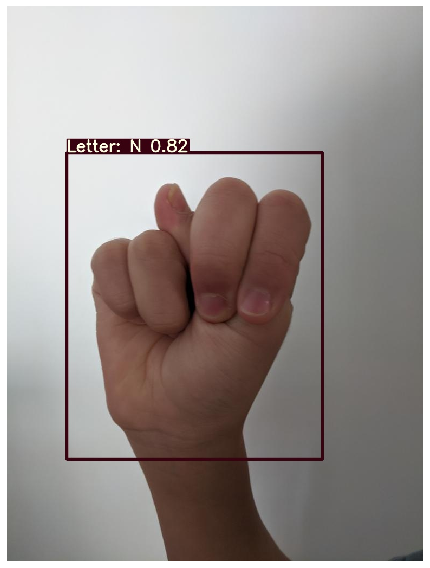

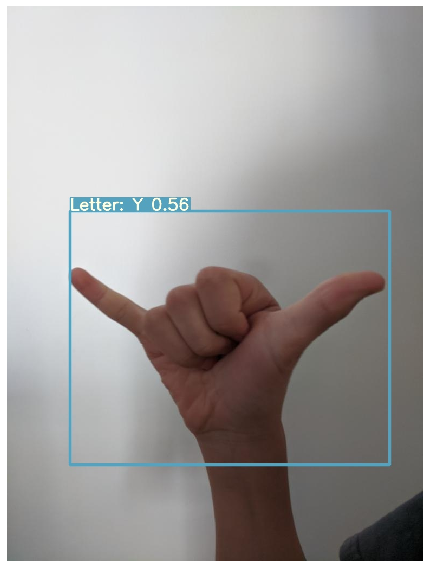

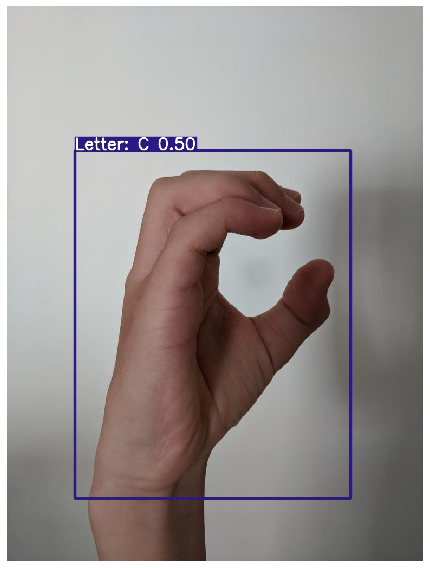

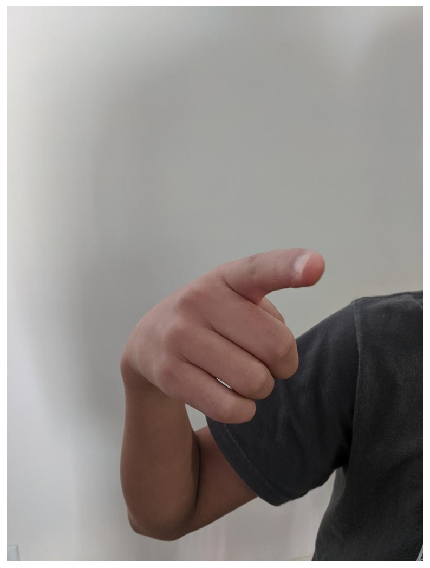

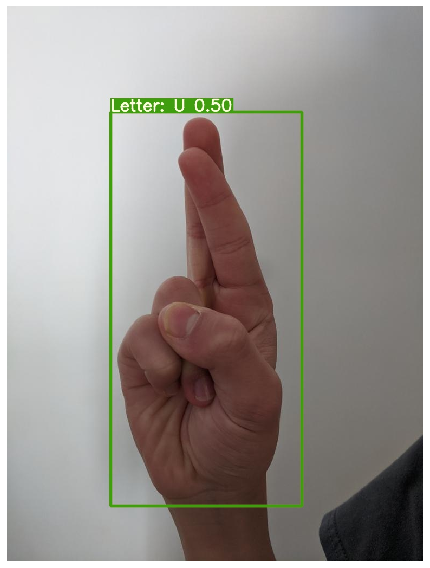

...

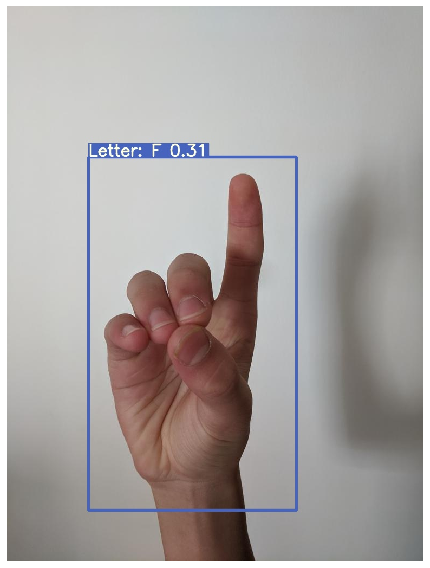

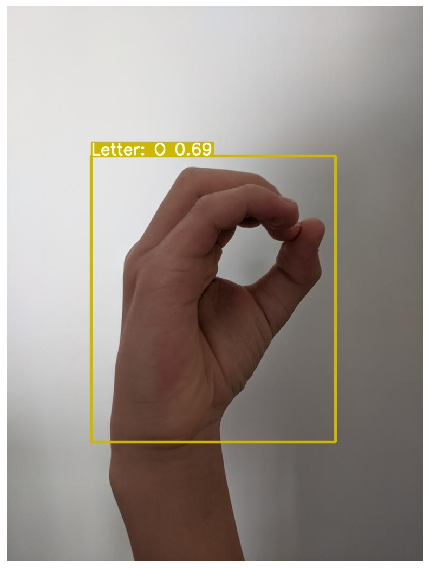

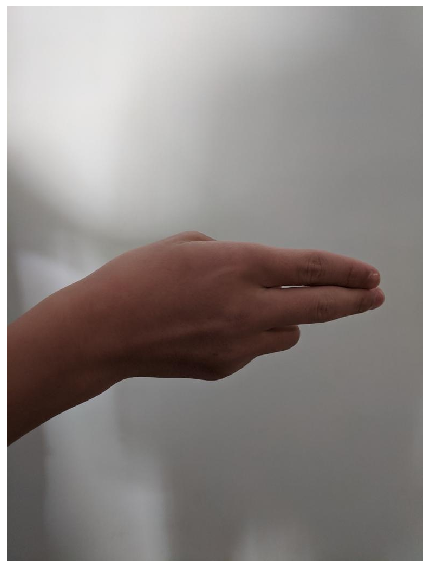

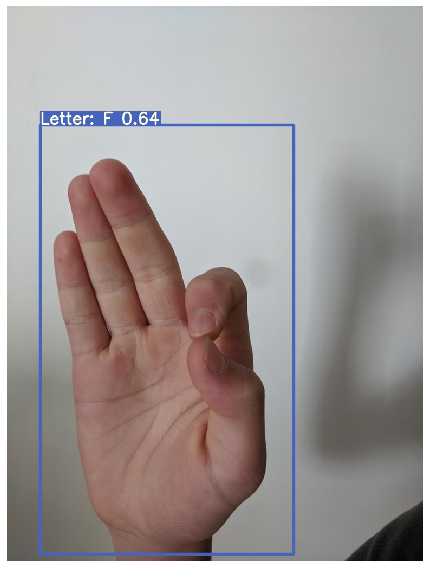

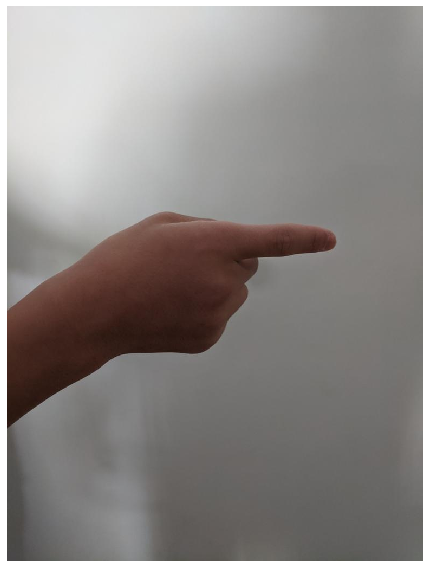

In [18]:
pred_images = '../test/images_pred/'
for file in os.listdir(pred_images):
    image = cv2.imread(pred_images + file)
    f = plt.figure(figsize=(8,8))
    plt.imshow(
        cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
        interpolation='nearest'
    )
    plt.axis('off')
    f.tight_layout()
    plt.show()
        

### Out of the total 26 letters in this test example, 4 letters did not show a prediction, and 4 gave an incorrect prediction at a 30% confidence threshhold.

Letters that did not show any prediction: Z, J, H, and G  
Letters that gave an incorrect prediction:   
T (predicted U),  
Q (predicted P),  
E (predicted T),  
F (predicted D)


## Inference via webcam
The command used is below.

In [35]:
# !python detect.py --source 0 --img 1024 --weights best.pt --conf .4 

### Each Letter of the Alphabet

In [38]:
Video("../test/screen_recording_pred/alphabet_screen_record_pred.mp4", embed=True, width=512)

## Left Handed

In [39]:
Video("../test/screen_recording_pred/left_handed_screen_record_pred4.mp4", embed=True, width=512)

## Limitations Found

#### Distance

In [40]:
# Distance seems to be the main problem with my model as nearly all images were taken in close proximity of the camera.
Video("../test/screen_recording_pred/distance_limitation_screen_record_pred5.mp4", embed=True, width=512)



#### Background interference

In [41]:
# Due to the low initial image count, a variety of backgrounds was limited, resulting in the model having difficulty 
# inferencing in busy environments
Video("../test/screen_recording_pred/background_limitation_screen_record_pred3.mp4", embed=True, width=512)

## Predictions on videos sent to me from volunteers

In [37]:
# !python detect.py --source ../test/videos/ --img 1024 --weights best.pt --conf .2

In [ ]:
# Attempts at names from several volunteers
